<a href="https://colab.research.google.com/github/aiden-dm/CSCI-4170/blob/main/CSCI_4170_Homework_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Projects in AI and ML - Homework 2**
##**Aiden Drover-Mattinen**

# Task 1

## Package Imports and Installations

In [1]:
!pip install SALib

In [2]:
# Standard libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Scikit-learn modules
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import (
    train_test_split,
    GridSearchCV,
    cross_val_score,
    RepeatedStratifiedKFold
)
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import (
    make_scorer,
    recall_score,
    f1_score,
    confusion_matrix
)
from sklearn import metrics

# Imbalanced-learn
from imblearn.over_sampling import SMOTE

# Statsmodels
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Sobol Sensitivity Analysis (SALib)
from SALib.sample import saltelli
from SALib.analyze import sobol
from SALib.test_functions import Ishigami

# Graph visualization
from six import StringIO
from IPython.display import Image
import pydotplus

# Statistical tests
from scipy.stats import f_oneway

## Data Preprocessing

I take a very similar approach to processing the dataset I used for Homework 1. First I read in the CSV file and print out the first few rows.

In [3]:
# Load the data from a csv file
data = pd.read_csv('/content/drive/MyDrive/CSCI4170_Datasets/heart_disease.csv')

In [4]:
data.head()

,Age,Gender,Blood Pressure,Cholesterol Level,Exercise Habits,Smoking,Family Heart Disease,Diabetes,BMI,High Blood Pressure,...,High LDL Cholesterol,Alcohol Consumption,Stress Level,Sleep Hours,Sugar Consumption,Triglyceride Level,Fasting Blood Sugar,CRP Level,Homocysteine Level,Heart Disease Status
0,56.0,Male,153.0,155.0,High,Yes,Yes,No,24.991591,Yes,...,No,High,Medium,7.633228,Medium,342.0,NaN,12.969246,12.387250,No
1,69.0,Female,146.0,286.0,High,No,Yes,Yes,25.221799,No,...,No,Medium,High,8.744034,Medium,133.0,157.0,9.355389,19.298875,No
2,46.0,Male,126.0,216.0,Low,No,No,No,29.855447,No,...,Yes,Low,Low,4.440440,Low,393.0,92.0,12.709873,11.230926,No
3,32.0,Female,122.0,293.0,High,Yes,Yes,No,24.130477,Yes,...,Yes,Low,High,5.249405,High,293.0,94.0,12.509046,5.961958,No
4,60.0,Male,166.0,242.0,Low,Yes,Yes,Yes,20.486289,Yes,...,No,Low,High,7.030971,High,263.0,154.0,10.381259,8.153887,No


Next, I drop the alcohol column because a high proportion (about 25%) of the rows in the dataset have a missing value for this feature.

In [5]:
# Drop the alcohol consumption column and print beginning of new data
data.drop('Alcohol Consumption', axis=1, inplace=True)

Next, I deal with the remaining missing values, replacing numerical missing values with the median and categorical values with the mode.

In [6]:
# Separate numerical and categorical columns
numerical_cols = data.select_dtypes(include=['float64']).columns
categorical_cols = data.select_dtypes(include=['object']).columns

# Replace missing values in numerical columns with the median
for column in numerical_cols:
    data[column] = data[column].fillna(data[column].median())

# Replace missing values in categorical columns with the mode
for column in categorical_cols:
    data[column] = data[column].fillna(data[column].mode()[0])

In [7]:
# Check that there are no remaining rows with empty data
rows_with_nan = data.isna().any(axis=1).sum()
print(f"Number of rows with empty data: {rows_with_nan}")

Number of rows with empty data: 0


To ensure that the categorical values can be understood by the models, I map the values to appropriate integer values.

In [8]:
# Mapping categorical values to numerical values
data['Gender'] = data['Gender'].map({'Male': 0, 'Female': 1})
data['Exercise Habits'] = data['Exercise Habits'].map({'Low': 0, 'Medium': 1, 'High': 2})
data['Smoking'] = data['Smoking'].map({'No': 0, 'Yes': 1})
data['Family Heart Disease'] = data['Family Heart Disease'].map({'No': 0, 'Yes': 1})
data['Diabetes'] = data['Diabetes'].map({'No': 0, 'Yes': 1})
data['High Blood Pressure'] = data['High Blood Pressure'].map({'No': 0, 'Yes': 1})
data['Low HDL Cholesterol'] = data['Low HDL Cholesterol'].map({'No': 0, 'Yes': 1})
data['High LDL Cholesterol'] = data['High LDL Cholesterol'].map({'No': 0, 'Yes': 1})
data['Stress Level'] = data['Stress Level'].map({'Low': 0, 'Medium': 1, 'High': 2})
data['Sugar Consumption'] = data['Sugar Consumption'].map({'Low': 0, 'Medium': 1, 'High': 2})
data['Heart Disease Status'] = data['Heart Disease Status'].map({'No': 0, 'Yes': 1})

Next, I check for multicollinearity using the Variance Inflation Factor (VIF).

In [9]:
# Extract all of the independent features and store them in X
features = data.drop(columns=['Heart Disease Status'])

# Create dataframe to store the VIF results
vif_data = pd.DataFrame()
vif_data["feature"] = features.columns

# Generate the VIF data
vif_data["VIF"] = [variance_inflation_factor(features.values, i)
                          for i in range(len(features.columns))]

# Print the VIF dataframe
print(vif_data)

                 feature        VIF
0                    Age   8.035321
1                 Gender   1.987443
2         Blood Pressure  46.629482
3      Cholesterol Level  24.262135
4        Exercise Habits   2.522336
5                Smoking   2.053728
6   Family Heart Disease   1.982906
7               Diabetes   1.978476
8                    BMI  20.223289
9    High Blood Pressure   2.016464
10   Low HDL Cholesterol   2.001309
11  High LDL Cholesterol   1.970567
12          Stress Level   2.489245
13           Sleep Hours  15.692714
14     Sugar Consumption   2.442352
15    Triglyceride Level   8.974641
16   Fasting Blood Sugar  23.488855
17             CRP Level   3.912226
18    Homocysteine Level   8.873372


I remove variables with high multicollinearity scores, specifically, Blood Pressure, Cholesterol Level, BMI, Sleep Hours, and Fasting Blood Pressure. I choose to keep features with a VIF score of around 8 despite being relatively high, so that information is not lost unecessarily from the dataset.

In [10]:
# Removing variables with high multicollinearity
for column in ['Blood Pressure', 'Cholesterol Level', 'BMI', 'Sleep Hours', 'Fasting Blood Sugar']:
  data.drop(column, axis=1, inplace=True)

In [11]:
data.head()

,Age,Gender,Exercise Habits,Smoking,Family Heart Disease,Diabetes,High Blood Pressure,Low HDL Cholesterol,High LDL Cholesterol,Stress Level,Sugar Consumption,Triglyceride Level,CRP Level,Homocysteine Level,Heart Disease Status
0,56.0,0,2,1,1,0,1,1,0,1,1,342.0,12.969246,12.387250,0
1,69.0,1,2,0,1,1,0,1,0,2,1,133.0,9.355389,19.298875,0
2,46.0,0,0,0,0,0,0,1,1,0,0,393.0,12.709873,11.230926,0
3,32.0,1,2,1,1,0,1,0,1,2,2,293.0,12.509046,5.961958,0
4,60.0,0,0,1,1,1,1,0,0,2,2,263.0,10.381259,8.153887,0


Next, I perform one-hot encoding on the categorical columns, as it consistently yielded better performance during my testing throughout the completion of this homework.

In [12]:
# List of categorical columns to encode
categorical_columns = [
    'Gender',
    'Exercise Habits',
    'Smoking',
    'Family Heart Disease',
    'Diabetes',
    'High Blood Pressure',
    'Low HDL Cholesterol',
    'High LDL Cholesterol',
    'Stress Level',
    'Sugar Consumption'
]

# Apply one-hot encoding using pandas' get_dummies
data = pd.get_dummies(data, columns=categorical_columns, drop_first=False)

# Change true false values to 1 and 0
data = data.replace({True: 1, False: 0}).infer_objects(copy=False)

<ipython-input-12-7c1d29969c0f>:19: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  data = data.replace({True: 1, False: 0}).infer_objects(copy=False)


In [13]:
data.head()

,Age,Triglyceride Level,CRP Level,Homocysteine Level,Heart Disease Status,Gender_0,Gender_1,Exercise Habits_0,Exercise Habits_1,Exercise Habits_2,...,Low HDL Cholesterol_0,Low HDL Cholesterol_1,High LDL Cholesterol_0,High LDL Cholesterol_1,Stress Level_0,Stress Level_1,Stress Level_2,Sugar Consumption_0,Sugar Consumption_1,Sugar Consumption_2
0,56.0,342.0,12.969246,12.387250,0,1,0,0,0,1,...,0,1,1,0,0,1,0,0,1,0
1,69.0,133.0,9.355389,19.298875,0,0,1,0,0,1,...,0,1,1,0,0,0,1,0,1,0
2,46.0,393.0,12.709873,11.230926,0,1,0,1,0,0,...,0,1,0,1,1,0,0,1,0,0
3,32.0,293.0,12.509046,5.961958,0,0,1,0,0,1,...,1,0,0,1,0,0,1,0,0,1
4,60.0,263.0,10.381259,8.153887,0,1,0,1,0,0,...,1,0,1,0,0,0,1,0,0,1


## Implementing a Decision Tree Classifier

First I split the data into X and y partitions.

In [14]:
# Split the data into dependent and independent variables
X = data.drop('Heart Disease Status', axis=1)
y = data['Heart Disease Status']

I then had to handle imbalance in the data, as the majority class (people without heart disease) make up approximately 80% of the dataset. I chose to use Synthetic Minority Oversampling (SMOTE) to generate more samples in the minority class (people with heart disease). I could have reduced the majority class with Random Undersampling, however, this would require reducing the majority class from approximately 8000 to 2000 samples - a significant loss of data that I figured would impact the quality of the model.

In [15]:
# Implementing SMOTE to balance the dataset
smote = SMOTE()
X, y = smote.fit_resample(X, y)  # Convert to numpy for SMOTE

I divided the X and y data into training and testing sections. Specifically, I randomly allocated 70% of the data to training, and the remaining 30% to testing. I will perform cross validation on the model later in the homework when I compare the Decision Tree Classifier to a Bagging and a Boosting algorithm. The point of this single partitioning of the data is to get a better understanding of how the model works.

In [16]:
# Split the data into training and testing segments
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) # 70% training and 30% test

Now, I create the Decision Tree Classifier model and fit it to my training data. I generate a list of predictions and print the accuracy.

In [17]:
# Create the Decision Tree classifier object
clf = DecisionTreeClassifier()  # Automatically adjust weights

# Train the Decision Tree Classifier
clf = clf.fit(X_train, y_train)

# Predict the response for test dataset
y_pred = clf.predict(X_test)

In [18]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.785625


With approximately 79% accuracy, the Decision Tree Classifier is outperforming all of my Logistic Regression implementations from Homework 1. This suggests that the relationships between features in the dataset are likely non-linear, making it challenging for Logistic Regression to model them effectively. Additionally, it indicates that the relationships between features may be more complex than Logistic Regression can handle, while the Decision Tree Classifier is better suited for capturing this complexity.

## Visualize the Decision Tree

The next step is to modify a few parameters of the Decision Tree Classifier and visualize each resulting tree to better understand the impacts of each parameter. I chose to modify the following four:

* Max Depth
* Min Samples Split
* Min Impurity Decrease

### Creating Function to Test Parameter Settings

To make my code more reusable, I created the following function to print a given decision tree.

In [19]:
def print_tree(data, clf):
  # Extract the feature columns
  feature_cols = list(data.columns)

  # Print out the decision tree
  dot_data = StringIO()
  export_graphviz(clf, out_file=dot_data,
                  filled=True, rounded=True,
                  special_characters=True,feature_names = feature_cols,class_names=['0','1'])
  graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
  display(Image(graph.create_png()))

This function is used to automatically test a range of different values for a particular parameter of the Decision Tree Classifier. It repeatedly fits a Decision Tree Classifier to the data using one of the parameters, gives the accuracy, prints the tree, then moves to the next value until all have been tested.

In [20]:
def test_parameters(X, y, parameter, values):

  # Split the data into training and testing segments
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

  for value in values:
    # Print a message for the current value
    print(f"Testing the value {value} for the parameter {parameter}\n")

    # Create parameter object
    tree_params = {parameter: value}

    # Create the Decision Tree classifier object
    clf = DecisionTreeClassifier(**tree_params, class_weight='balanced')

    # Train the Decision Tree Classifier
    clf = clf.fit(X_train, y_train)

    # Predict the response for test dataset
    y_pred = clf.predict(X_test)

    # Train the Decision Tree Classifier
    clf = clf.fit(X_train, y_train)

    # Predict the response for test dataset
    y_pred = clf.predict(X_test)

    # Model Accuracy, how often is the classifier correct?
    print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

    # Print out the decision tree
    print_tree(X, clf)

### Max Depth

The max depth parameter of the Decision Tree Classifier controls the maximum number of levels the tree can grow to. It is one of the key parameters used to prevent overfitting or underfitting. I chose to test the values 1, 2, 4, 6, and 10.

Testing the value 1 for the parameter max_depth

Accuracy: 0.6041666666666666


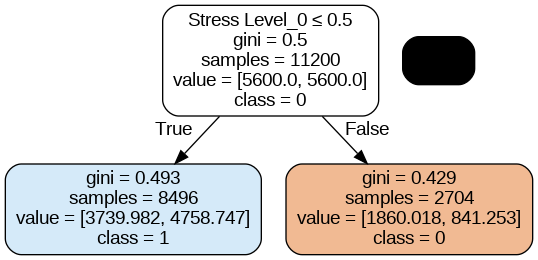

Testing the value 2 for the parameter max_depth

Accuracy: 0.6929166666666666


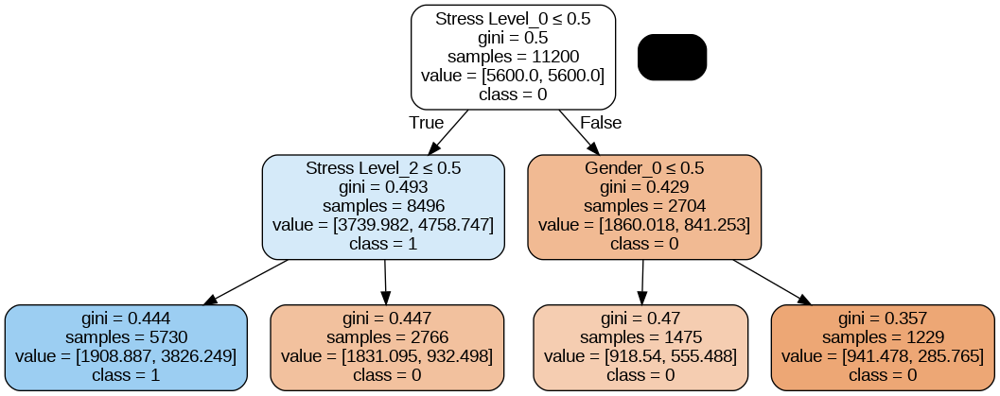

Testing the value 4 for the parameter max_depth

Accuracy: 0.793125


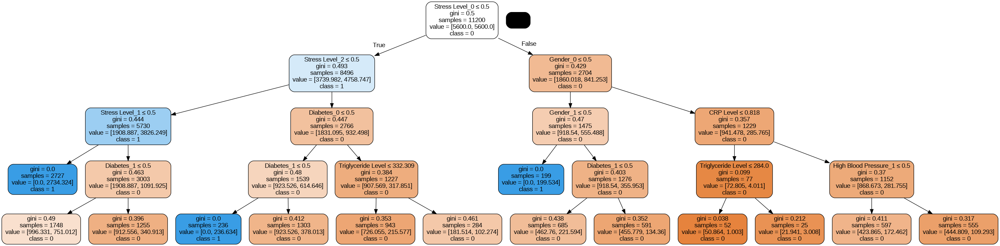

Testing the value 6 for the parameter max_depth

Accuracy: 0.82875


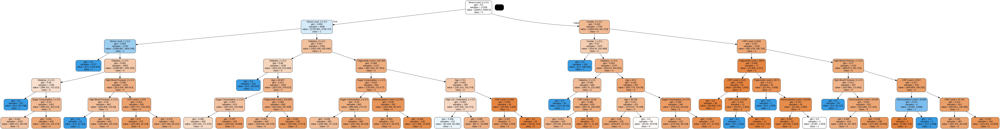

Testing the value 10 for the parameter max_depth

Accuracy: 0.8320833333333333
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.726605 to fit



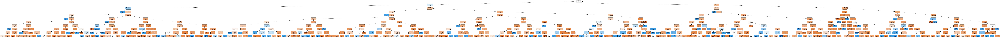

In [21]:
test_parameters(X, y, "max_depth", [1, 2, 4, 6, 10])

As the tree grows deeper, it generates more nodes, enabling it to capture increasingly complex relationships between the features in the data, which is often reflected in higher accuracy scores on the training set. However, this added complexity also heightens the risk of overfitting, where the model becomes overly specialized to the training data. Consequently, its ability to generalize to unseen or foreign datasets diminishes, potentially leading to poorer performance in real-world scenarios.

### Min Samples Split

The min_samples_split parameter of the Decision Tree Classifier specifies the minimum number of samples required to split an internal node. Basically, this means that it determines how large a group of data points at a node needs to be before the algorithm considers splitting it further. To test this parameter, I have chosen to use values 10, 50, 100, and 500.

Testing the value 10 for the parameter min_samples_split

Accuracy: 0.78875
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.450598 to fit



Testing the value 50 for the parameter min_samples_split

Accuracy: 0.82125


Testing the value 100 for the parameter min_samples_split

Accuracy: 0.8352083333333333


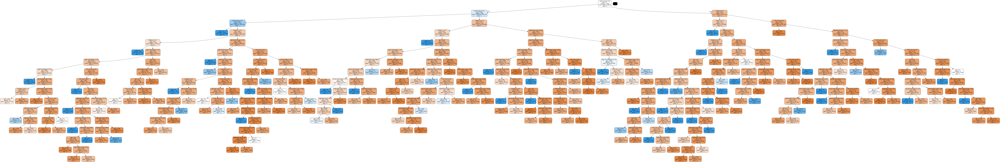

Testing the value 500 for the parameter min_samples_split

Accuracy: 0.843125


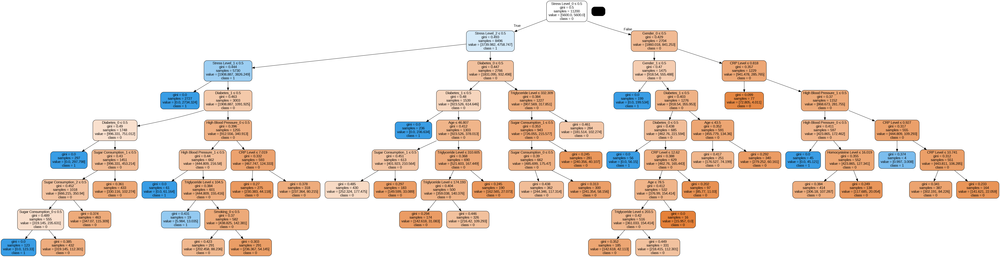

In [22]:
test_parameters(X, y, "min_samples_split", [10, 50, 100, 500])

Smaller values of min_samples_split allow the tree to split more frequently, resulting in a deeper and more complex structure. This enables the model to capture more detailed relationships within the training data, potentially improving its fit. However, this also increases the risk of overfitting, as the model may become too tailored to the noise in the data.

As the min_samples_split value increases, the tree becomes shallower and less complex, which can help prevent overfitting but may lead to underfitting if the model is too simplistic. Interestingly, a min_samples_split value of 100 yielded the highest accuracy score in this case, demonstrating that the optimal value is not necessarily the smallest or largest, but rather depends on the specific characteristics of the training data.

### Min Impurity Decrease

The min_impurity_decrease parameter of the Decision Tree Classifier controls the minimum decrease in impurity required for a split to occur. In the context of decision trees, impurity refers to the measure of how mixed the target labels are within a given node. The goal of a decision tree is to create nodes (splits) where the samples within each node are as pure as possible. To test this parameter, I've selected the values 0.0, 0.001, 0.01, 0.1 and 0.2.

Testing the value 0.0 for the parameter min_impurity_decrease

Accuracy: 0.78875
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.263326 to fit



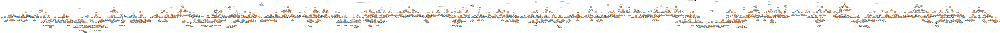

Testing the value 0.001 for the parameter min_impurity_decrease

Accuracy: 0.8177083333333334


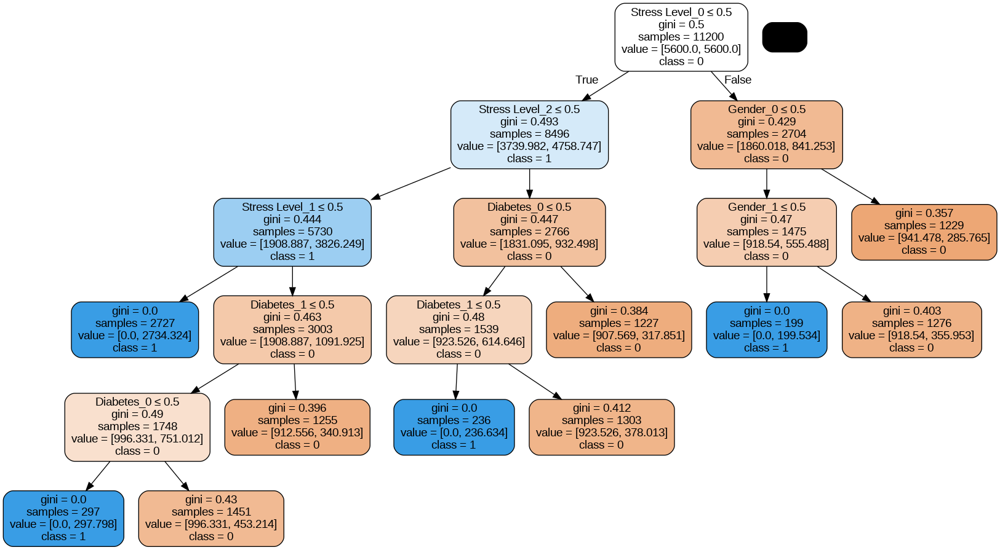

Testing the value 0.01 for the parameter min_impurity_decrease

Accuracy: 0.7547916666666666


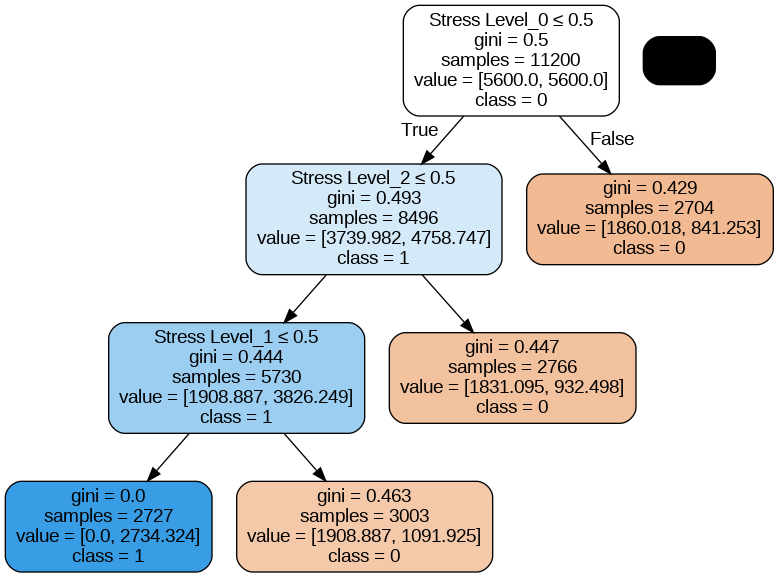

Testing the value 0.1 for the parameter min_impurity_decrease

Accuracy: 0.496875


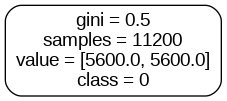

Testing the value 0.2 for the parameter min_impurity_decrease

Accuracy: 0.496875


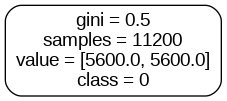

In [23]:
test_parameters(X, y, "min_impurity_decrease", [0.0, 0.001, 0.01, 0.1, 0.2])

As the value of min_impurity_decrease increases, the depth and complexity of the tree decrease significantly, with only one node remaining when the value reaches 0.1 and 0.2. This behavior makes sense because a lower min_impurity_decrease value allows the tree to split even with a small reduction in impurity, leading to deeper and more complex trees. In contrast, higher values such as 0.1 and 0.2 require a more substantial decrease in impurity for a split to occur, resulting in fewer splits and a shallower tree. Interestingly, a value of 0.001 produced the best accuracy, suggesting that the optimal min_impurity_decrease value is highly dependent on the specific dataset and the relationships between its features.

## Performing Sensitivity Analysis

The point of sensitivity analysis is to understand how each parameter or combination of parameters impacts the predictions of a model. Models are often complex, which can hurt interpretability. Sensitivity analysis helps regain some of this interpretability.

A common approach to sensitivity analysis is to hold all features constant except one, tweaking this flexible feature and observing the model's response. However, this approach—known as local or one-at-a-time sensitivity analysis—overlooks the interactions between features. For models with many features and complex relationships, global sensitivity analysis is more appropriate as it accounts for these interactions.

One widely used technique for global sensitivity analysis is Sobol Sensitivity Analysis. It assumes that any numerical computer model $f$, with parameters $X$ and response $Y = f(X)$, can be decomposed into summands of different dimensions:

$$ y = f(X) = f_{0} + \sum_{n=1}^{N_{p}} f_{n}(x_{n}) + \sum_{1 \leq n \leq n' \leq N_p} f_{n, n'}(x_{n}, x_{n'}) + ... + f_{1, 2, ..., N_p}(x_{1}, ..., x_{N_{p}})$$

In simpler terms, this means the model is expressed as a sum of contributions: a constant term ($f_{0}$), contributions from individual features ($f_{n}(x_{n})$), two-way interactions ($f_{n, n'}(x_{n}, x_{n'})$), and so on.

To quantify how much of the output's variance ($Var(Y)$) is explained by a particular feature ($X_{n}$), we use the ratio:

$$\frac{Var[E(Y|X_{n}=x_{n})]}{Var(Y)}$$

The total variance of the model can be decomposed into partial variances as follows:

$$ Var(Y) = \sum_{n=1}^{N_{p}} D_{n} + \sum_{1 \leq n \leq n' \leq N_p} D_{n,n'} + ... + D_{1,2,...,N_{p}} \\
D_{n}=Var[E(Y|X_{n}] \\
D_{n,n'}=Var[E(Y|X_{n},X_{n'})] - D_{n} - D_{n'}$$

The variance of the constant term is 0, $D_{n}$ is the variance associated with an individual feature, and $D_{n,n'}$ is the variance associated with the combination of two features (we make sure to subtract the variances associated with each of the individual features involved so they do not skew the value).

Each partial variance, normalized by the total variance, gives us Sobol indices:

$$S_{n}=\frac{D_{n}}{Var(Y)}, S_{n,n'}=\frac{D_{n,n'}}{Var(Y)}, ..., S_{1,2,...,N_{p}}=\frac{D_{1,2,...,N_{p}}}{Var(Y)}$$

The first-order Sobol index ($S_n$) measures the impact of $X_n$ alone. The total effect index ($S_{T_{n}}$) includes $X_n$'s individual effect all all interactions involving $X_n$.

$$S_{T_{n}}=S_{n}+\sum_{n<n'}S_{n,n'}+\sum_{n'\neq n, n'' \neq n, n' < n''}S_{n,n',n''}+...$$

While these calculations are complex, libraries like SALib make them accessible. Using SALib, I implemented Sobol Sensitivity Analysis for my model and calculated the first-order and total effect indices. Visualizing these indices allowed me to identify the most influential features and their interactions, improving my understanding of the model.

The following is a list of steps I will complete in the code to complete the sensitivity analysis:
1. Train the Model: Train a DecisionTreeClassifier using the training data (X_train, y_train).
2. Define the Problem: Define the input variables (features) and their bounds (min and max values) in a problem dictionary.
3. Generate Samples: Use Saltelli’s method to generate input samples (param_values) for the Sobol analysis.
4. Evaluate the Classifier: Define a function (evaluate_classifier) to make predictions on the generated samples using the trained model.
5. Perform Sobol Analysis: Use sobol.analyze() to calculate first-order and total-order Sobol indices based on the model's predictions.
6. Display Results: Print the first-order (S1) and total-order (ST) Sobol indices.
7. Plot the Indices:
Create a bar plot for the first-order and total-order Sobol indices.
Add labels, a title, and a legend mapping feature numbers to names.

Sources:
* https://www.researchgate.net/publication/228547505_Global_sensitivity_analysis_An_introduction
* https://www.youtube.com/watch?v=vBuWB9WuFhA
* https://salib.readthedocs.io/en/latest/



<ipython-input-24-6a31dcdbd073>:19: DeprecationWarning: `salib.sample.saltelli` will be removed in SALib 1.5.1 Please use `salib.sample.sobol`
  param_values = saltelli.sample(problem, 1024)
/usr/local/lib/python3.11/dist-packages/SALib/util/__init__.py:274: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  names = list(pd.unique(groups))


First-order Sobol indices (S1): [ 1.98739497e-02  8.32952306e-03 -2.36733813e-02  2.03123457e-02
  4.60315748e-02  4.00401635e-02 -5.11461942e-03  2.48424372e-03
 -4.82235545e-03 -4.33410148e-19  3.94556355e-03  1.47593303e-02
 -1.22750866e-02  1.97278178e-02  5.11461942e-02  3.05415845e-02
  2.98109246e-02  1.46131983e-03  3.21490364e-03  1.21289546e-02
  6.42980727e-03 -1.16905587e-03  1.63667821e-02 -9.49857892e-03
  2.19197975e-03 -4.53009149e-03 -8.91405099e-03]
Total-order Sobol indices (ST): [0.19640139 0.18208045 0.15548443 0.14934689 0.27618945 0.15139273
 0.0470545  0.00613754 0.01022924 0.02045848 0.03068772 0.02659602
 0.03273356 0.22299741 0.25368512 0.14525519 0.17185121 0.02045848
 0.03273356 0.02659602 0.02455017 0.45008651 0.10638408 0.23936419
 0.06751298 0.10433824 0.0429628 ]


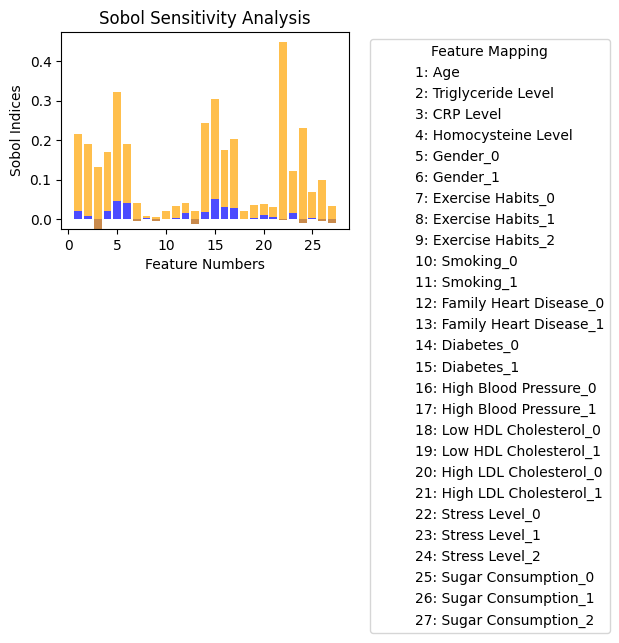

In [24]:
# Train the DecisionTreeClassifier
sobol_clf = DecisionTreeClassifier(random_state=1)
sobol_clf.fit(X_train, y_train)

# Get column names and bounds information
names = X_train.columns.tolist()
min_values = X_train.min().tolist()
max_values = X_train.max().tolist()
bounds = list(zip(min_values, max_values))

# Define the problem for Sobol analysis
problem = {
    'num_vars': len(names),
    'names': names,
    'bounds': bounds  # Min and max for each factor
}

# Generate input samples using Saltelli's method
param_values = saltelli.sample(problem, 1024)

# Define a function to evaluate the classifier
def evaluate_classifier(X):
    X_df = pd.DataFrame(X, columns=problem['names'])
    X_df.head()
    # Predict probabilities for the positive class
    return sobol_clf.predict_proba(X_df)[:, 1]

# Evaluate the model on the generated samples
Y = evaluate_classifier(param_values)

# Perform Sobol analysis
sobol_indices = sobol.analyze(problem, Y)

# Display results
print("First-order Sobol indices (S1):", sobol_indices['S1'])
print("Total-order Sobol indices (ST):", sobol_indices['ST'])

# Assign numbers to each feature for the x-axis
feature_numbers = list(range(1, len(problem['names']) + 1))

# Create a mapping of numbers to feature names for the legend
feature_mapping = {num: name for num, name in zip(feature_numbers, problem['names'])}

# Plot First-order indices
plt.bar(feature_numbers, sobol_indices['S1'], color='blue', alpha=0.7, label='S1')

# Plot Total-order indices
plt.bar(feature_numbers, sobol_indices['ST'], color='orange', alpha=0.7, label='ST', bottom=sobol_indices['S1'])

# Add labels and title
plt.xlabel("Feature Numbers")
plt.ylabel("Sobol Indices")
plt.title("Sobol Sensitivity Analysis")
plt.legend()

# Add a legend to map numbers to feature names
legend_elements = [plt.Line2D([0], [0], color='white', lw=0, label=f"{num}: {name}")
                   for num, name in feature_mapping.items()]
plt.legend(handles=legend_elements, title="Feature Mapping", loc="upper left", bbox_to_anchor=(1.05, 1))

# Show the plot
plt.tight_layout()
plt.show()


The Sobol Sensitivity Analysis revealed Stress Level_0, Gender_0, and Diabetes_1 as the most influential features driving the model's predictions.

Stress Level_0 had a significant impact, though this result seems counterintuitive since lower stress levels are typically linked to better health outcomes. This sensitivity could suggest that the model disproportionately relies on low-stress samples to predict the majority class (no disease). The dataset's class imbalance may be introducing bias, amplifying the importance of this feature.

Gender_0, representing males, also demonstrated a large influence on the predictions. This is consistent with medical observations that heart disease prevalence is generally lower in women, making gender an important factor in heart disease prediction.

Lastly, Diabetes_1 emerged as a key predictor, aligning with established medical research that identifies diabetes as a significant contributor to heart conditions, including heart disease

Sources:
* https://www.health.harvard.edu/heart-health/the-heart-disease-gender-gap
* https://www.cdc.gov/diabetes/diabetes-complications/diabetes-and-your-heart.html



# Task 2

To improve upon the performance achieved by the Decision Tree Classifier, I plan to implement a Bagging method and a Boosting method. Specifically, I will use Random Forest for Bagging and Gradient Boosting for Boosting.

To compare the performance of these algorithms, I will perform k-fold cross-validation with fold counts of 5, 10, and 15 for all three models. Afterward, I will average the results for each fold count and use these averages to compare the performance of the three algorithms.

The following is a function that I will be using to collect the performance metric data:

In [25]:
def get_metrics(model, X, y):
  # Store results from each fold
  metrics = ['accuracy', 'recall', 'f1']
  folds = [5, 10, 15]
  results = {metric: {fold: [] for fold in folds} for metric in metrics}

  # Calculate the metrics for each fold
  for fold in folds:
    # Define the cross validation for the particular fold
    cv = RepeatedStratifiedKFold(n_splits=fold, n_repeats=1, random_state=1)

    for metric in metrics:
      # Get results for the particular metric
      results[metric][fold] = cross_val_score(model, X, y, scoring=metric, cv=cv, n_jobs=-1, error_score='raise')

    print(f"Completed calculating metrics for folds k = {fold}")

  # Return the results gathered during the process
  return results


## Bagging: Random Forest

Random Forest is an algorithm similar to the Decision Tree, but it uses the bagging method for training. The core idea behind bagging is that combining multiple learning models can improve the overall performance. In the case of Random Forest, a collection of smaller, random trees are built and then combined into a larger tree used for classification. Instead of selecting the most important feature when splitting a node, Random Forest chooses the best feature from a randomly sampled subset of features. This added randomness introduces diversity, which generally leads to better performance compared to a single Decision Tree.

The following is my implementation of Random Forest:

Source:
* https://builtin.com/data-science/random-forest-algorithm#:~:text=Random%20forest%20is%20a%20predictive,other%20approaches%20would%20be%20better.



In [26]:
# Creating the Random Forest Classifier
rf = RandomForestClassifier()

# Run k-fold cross validaiton and collect results
rf_results = get_metrics(rf, X, y)

Completed calculating metrics for folds k = 5
Completed calculating metrics for folds k = 10
Completed calculating metrics for folds k = 15


As shown above, the accuracy of Random Forest is significantly higher than that of the Decision Tree. This is expected, as the increased diversity from random sampling has enabled the model to better capture the patterns within the training data. We also observe high values for recall and F1 Score, with low standard deviation, indicating consistent performance.

## Boosting: Gradient Boost

Gradient Boosting is an algorithm that builds on the foundation of Decision Trees but improves performance by training sequentially, with each new tree correcting the errors of the previous one. Unlike Random Forest, which combines trees built independently using bagging, Gradient Boosting relies on boosting, a method that focuses on reducing bias in predictions.

At each step, Gradient Boosting identifies patterns in the residuals (the differences between the actual and predicted values) and fits a new tree to these errors. The contributions of each tree are weighted and combined into the overall model, enabling it to iteratively refine its predictions. This sequential approach often results in higher accuracy and better generalization than single Decision Trees, especially on complex datasets.

Source:
* https://www.digitalocean.com/community/tutorials/gradient-boosting-for-classification

In [27]:
# Creating the Gradient Boosting Classifier
gb = GradientBoostingClassifier()

# Run k-fold cross validaiton and collect results
gb_results = get_metrics(gb, X, y)

Completed calculating metrics for folds k = 5
Completed calculating metrics for folds k = 10
Completed calculating metrics for folds k = 15


## Random Forest vs. Gradient Boosting Behavior

To better compare the performance and behavior of Random Forest and Gradient Boosting, I printed out the averages of their performance metrices side by side.

In [28]:
# Defining the folds
folds = [5, 10, 15]

# Printing a table comparing the results of each fold
for fold in folds:
  # Get Random Forest information
  rf_accuracy = rf_results['accuracy'][fold].mean()
  rf_recall = rf_results['recall'][fold].mean()
  rf_f1 = rf_results['f1'][fold].mean()

  # Get Gradient Boosting information
  gb_accuracy = gb_results['accuracy'][fold].mean()
  gb_recall = gb_results['recall'][fold].mean()
  gb_f1 = gb_results['f1'][fold].mean()

  # Print the table of information
  print(f"Random Forest vs. Gradient Boosting k={fold}")
  print(f"{'Metric':<10}{'Random Forest':<15}{'Gradient Boosting':<15}")
  print(f"{'Accuracy':<10}{rf_accuracy:<15.4f}{gb_accuracy:<15.4f}")
  print(f"{'Recall':<10}{rf_recall:<15.4f}{gb_recall:<15.4f}")
  print(f"{'F1-Score':<10}{rf_f1:<15.4f}{gb_f1:<15.4f}")
  print()

Random Forest vs. Gradient Boosting k=5
Metric    Random Forest  Gradient Boosting
Accuracy  0.8721         0.8739         
Recall    0.7531         0.7488         
F1-Score  0.8548         0.8557         

Random Forest vs. Gradient Boosting k=10
Metric    Random Forest  Gradient Boosting
Accuracy  0.8720         0.8739         
Recall    0.7539         0.7486         
F1-Score  0.8548         0.8558         

Random Forest vs. Gradient Boosting k=15
Metric    Random Forest  Gradient Boosting
Accuracy  0.8726         0.8742         
Recall    0.7535         0.7491         
F1-Score  0.8550         0.8560         



Across all k-fold tables, the same pattern is observed:

* Gradient Boosting marginally outperforms Random Forest in accuracy.
* Random Forest slightly outperforms Gradient Boosting in recall.
* Both algorithms deliver nearly identical F1-scores, with Gradient Boosting having a very slight edge.

The higher accuracy of Gradient Boosting can be attributed to its sequential tree-building process, where each tree corrects the errors of the previous ones. This iterative refinement often leads to more finely tuned models, especially on imbalanced datasets like ours, where Gradient Boosting tends to excel.

Random Forest, on the other hand, performed better in recall, meaning it identified a greater proportion of the actual positive cases. This could be due to Random Forest's inherent randomness and ensemble approach, which reduce overfitting and allow it to generalize better to the positive class, capturing more true positives in the process.

The nearly identical F1-scores suggest that both algorithms strike a similar balance between precision and recall. Additionally, their high F1-scores reflect strong overall learning performance, affirming that both models effectively handle the dataset.

For this healthcare application, I would lean toward using Random Forest. Correctly identifying individuals with the disease is crucial (missing a diagnosis has dangerous consequences!), making the higher recall score particularly valuable. Furthermore, Random Forest's computational efficiency compared to Gradient Boosting allows for more comprehensive training and scalability, which is advantageous when working with large datasets.

Sources:
* https://medium.com/@hassaanidrees7/gradient-boosting-vs-random-forest-which-ensemble-method-should-you-use-9f2ee294d9c6#:~:text=Random%20Forest%20is%20robust%2C%20fast,tuning%20and%20longer%20training%20times.



# Task 3

Now I want to compare the effectiveness of the three models implemented above: Decision Tree Classification, Random Forest, and Gradient Boosting.

## Confusion Matrix for One Fold

 A great way to compare effectiveness is with the use of a confusion matrix. I will create one fold, splitting the data into training and testing segments. I will train each algorithm on the training data, then make predictions and print a confusion matrix for each algorithm.

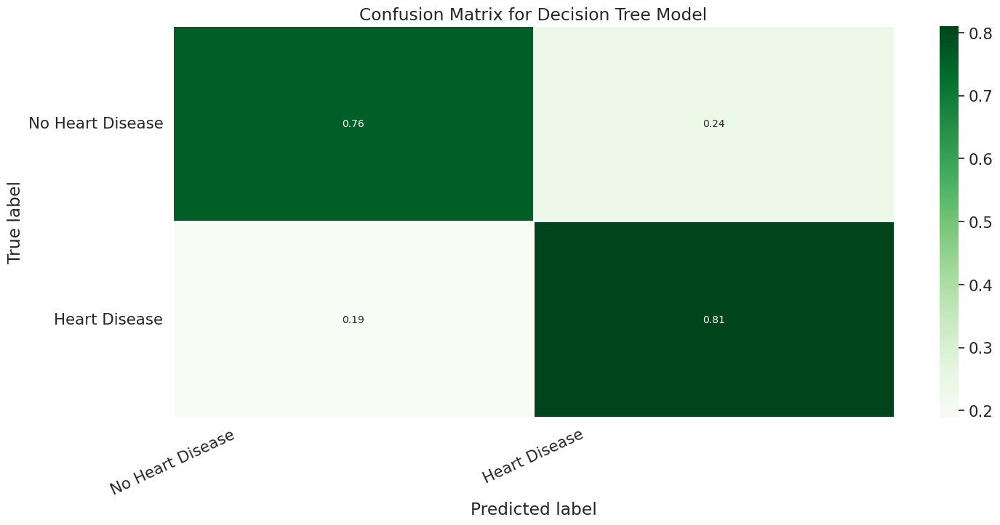

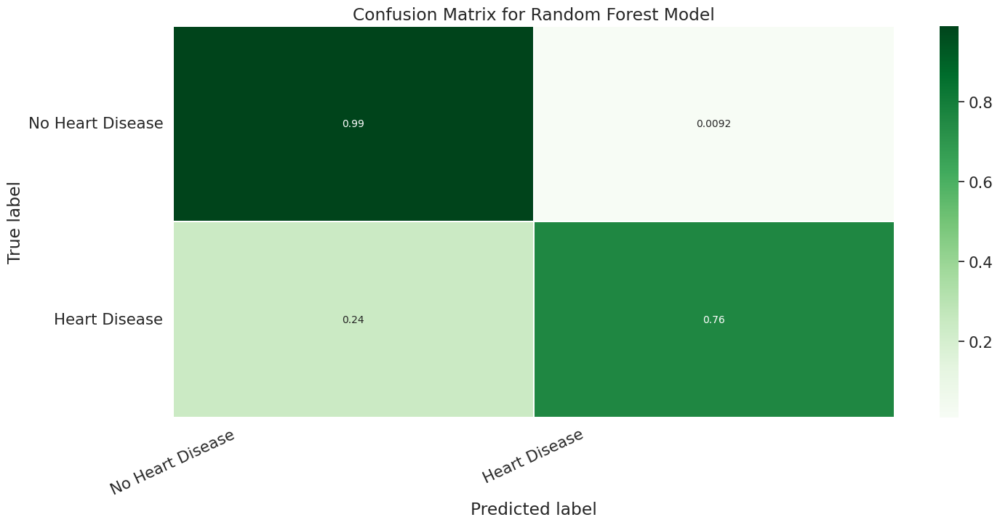

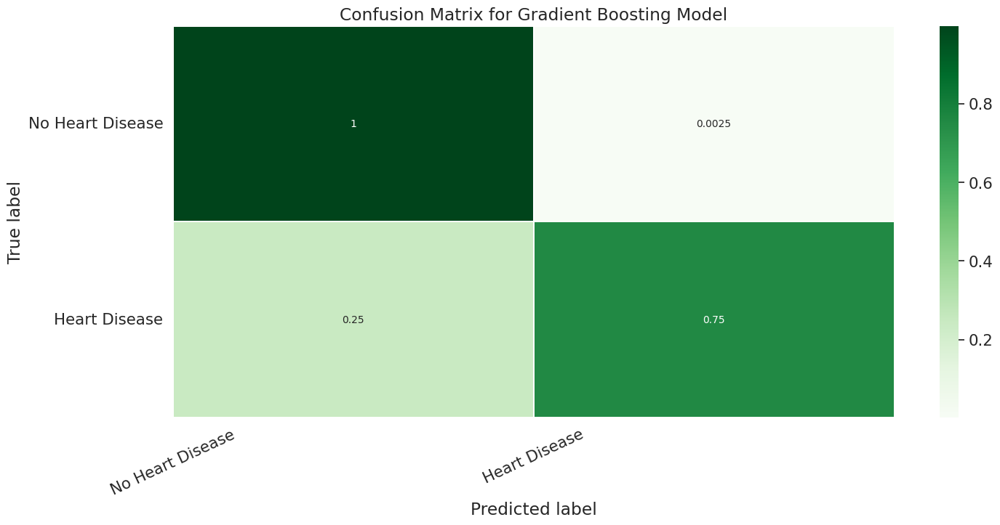

In [29]:
# Define the models
models = {
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'Gradient Boosting': GradientBoostingClassifier()
}

# Create the fold
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

for model in ['Decision Tree', 'Random Forest', 'Gradient Boosting']:

  # Fit the model and make predictions
  models[model].fit(X_train, y_train)
  y_pred = models[model].predict(X_test)

  # Create the confusion matrix
  matrix = confusion_matrix(y_test, y_pred)
  matrix = matrix.astype('float') / matrix.sum(axis=1)[:, np.newaxis]

  # Plot the confusion matrix
  plt.figure(figsize=(16,7))
  sns.set(font_scale=1.4)
  sns.heatmap(matrix, annot=True, annot_kws={'size':10},
              cmap=plt.cm.Greens, linewidths=0.2)

  # Add labels to the plot
  class_names = ['No Heart Disease', 'Heart Disease']
  tick_marks = np.arange(len(class_names))
  tick_marks2 = tick_marks + 0.5
  plt.xticks(tick_marks, class_names, rotation=25)
  plt.yticks(tick_marks2, class_names, rotation=0)
  plt.xlabel('Predicted label')
  plt.ylabel('True label')
  plt.title(f'Confusion Matrix for {model} Model')
  plt.show()





Using the confusion matrices above, we can conclude the following about the effectiveness of the three models:

* True Negatives (TN): All three models perform extremely well at predicting "No Heart Disease," with Random Forest and Gradient Boosting nearly reaching 100% accuracy in this area. This makes sense, as "No Heart Disease" is the majority class in the dataset.
* True Positives (TP): The Decision Tree performs the best at identifying "Heart Disease," though Random Forest and Gradient Boosting are not far behind.
* False Positives (FP): Random Forest and Gradient Boosting have very low false positive rates, meaning they rarely predict "Heart Disease" when the patient actually does not have it. The Decision Tree struggles slightly more in this regard.
* False Negatives (FN): Random Forest and Gradient Boosting have slightly higher false negative rates, meaning they miss more actual "Heart Disease" cases compared to the Decision Tree.

The following source helped with my implementation:
* https://medium.com/analytics-vidhya/evaluating-a-random-forest-model-9d165595ad56

## ANOVA Testing

Another approach to evaluate the performance of the algorithms relative to one another is through a one-way Analysis of Variance (ANOVA) test. I chose a one-way ANOVA because we are comparing the means of three independent groups (the three models) with respect to their performance metrics. If I wanted to compare with respect to performance groups and another factor, I would have to use multi-way ANOVA. ANOVA enables us to assess whether there are any statistically significant differences in the performance of all three algorithms by comparing their means. The test works by analyzing the variance within each group (in this case, the performance metrics of each algorithm) and between the groups (the differences between the algorithms). By comparing these variances, ANOVA helps determine whether the observed differences in performance are due to random variation or if they reflect true, meaningful distinctions between the algorithms.

In [30]:
# List of models
models = {
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'Gradient Boosting': GradientBoostingClassifier()
}

# List of metrics
metrics = ['accuracy', 'recall', 'f1']

# Initialize dictionary to hold scores for each model and metric
scores = {metric: {model: [] for model in models} for metric in metrics}

# Loop over each metric and calculate cross-validation scores
for metric in metrics:
    for model_name, model in models.items():
        # Calculate cross-validation scores for the current model and metric
        if metric == 'accuracy':
            score = cross_val_score(model, X, y, cv=10, scoring='accuracy')
        elif metric == 'recall':
            score = cross_val_score(model, X, y, cv=10, scoring=make_scorer(recall_score))
        elif metric == 'f1':
            score = cross_val_score(model, X, y, cv=10, scoring=make_scorer(f1_score))

        # Store the results
        scores[metric][model_name] = score

# Perform ANOVA for each metric
for metric in metrics:
    print(f"\nANOVA Results for {metric.capitalize()}:")
    # Extract the score arrays for each model
    score_arrays = [scores[metric][model] for model in models]

    # Perform ANOVA
    f_stat, p_value = f_oneway(*score_arrays)
    print(f"F-statistic = {f_stat}, p-value = {p_value}")



ANOVA Results for Accuracy:
F-statistic = 0.697217519950621, p-value = 0.506713160461826

ANOVA Results for Recall:
F-statistic = 0.045368923643981623, p-value = 0.9557175501411197

ANOVA Results for F1:
F-statistic = 0.007293233782099944, p-value = 0.9927352523377895


Before analyzing the results, let's first define the F-statistic and the p-value:

F-statistic: $F = \frac{\text{variation between sample means}}{\text{variation within the samples}}$
This ratio tells us how much the sample means vary compared to the variation within the samples.

p-value: The p-value helps us decide whether to accept or reject the null hypothesis in ANOVA. If the p-value is less than 0.05, we reject the null hypothesis, indicating that the observed differences are statistically significant. If the p-value is greater than 0.05, we fail to reject the null hypothesis, meaning there is no significant difference.

For accuracy, recall, and F1 scores, the p-values are above the threshold of 0.05. This means that there are no statistically significant differences in performance across the three models for these metrics. The observed differences in performance are likely due to random variation.

Thus, we can conclude that the models perform similarly across these metrics. Our selection of the model would, therefore, depend more on other factors such as computational complexity and interpretability rather than performance differences.

Sources:
* https://www.investopedia.com/terms/a/anova.asp
* https://blog.minitab.com/en/adventures-in-statistics-2/understanding-analysis-of-variance-anova-and-the-f-test
* https://www.statology.org/anova-f-value-p-value/
* https://www.geeksforgeeks.org/how-to-perform-a-one-way-anova-in-python/

## Bias-Variance Tradeoff Discussion

To properly discuss the bias-variance tradeoff, it's essential to first understand the two concepts:

Bias: A model is biased if it consistently over- or under-predicts the target variable. This often occurs due to assumptions made by the model or bias in the training data.

Variance: Variance measures how much a model's predictions would change if trained on a different dataset. It provides insight into the model's generalizability.

The bias-variance tradeoff suggests that increasing one typically leads to decreasing the other. The goal in machine learning is to find the point where both bias and variance are minimized.

Different models have varying bias-variance tradeoffs based on their characteristics. Here's a summary of how Decision Tree, Random Forest, and Gradient Boosting each handle this tradeoff:

Decision Tree: A Decision Tree can fit data extremely well, especially when deep and complex. This leads to low bias but high variance, as the model tends to overfit the training data and struggles to generalize to new datasets.

Random Forest: By using a bagging strategy to create multiple smaller trees and combining their results, Random Forest reduces overfitting seen in Decision Trees. This results in higher bias (since the trees are shallower and less granular) but lower variance, as the model captures more general patterns that are more likely to generalize to unseen data.

Gradient Boosting: Gradient Boosting fits very complex relationships, reducing bias. However, it also tends to overfit, increasing variance. Compared to Random Forest, Gradient Boosting typically has lower bias but higher variance, as it fits more complex models.

Sources:
* https://towardsdatascience.com/understanding-the-bias-variance-tradeoff-165e6942b229
* https://towardsdatascience.com/random-forests-and-the-bias-variance-tradeoff-3b77fee339b4





# Statement About Use of Generative AI

Throughout this project, I leveraged generative AI models to help refine the structure and grammar of my writing. I also used them to format some of my code for better readability and consulted them for guidance on which NumPy, Pandas, and other functions to use before researching and implementing them myself. All content presented is my own, and any external sources referenced for this assignment are properly cited or linked where appropriate. I wasn't sure of the exact citation format for AI usage, so I felt this paragraph would suffice.

I thoroughly enjoyed completing this assignment and deepening my understanding of so many new concepts!